## Coursera Capstone Project

### The Battle of Neighbourhood

Shujun Ye  | stellaye09@gmail.com

#### Project Background

XYZ Company want to open a new restaurant in New York. New York as a diverse and multicultural city, it provides lot of business oppourtunities and business friendly environment. It has attracted many different players into the market. 
This also means that the restaurant market is highly competitive here. Now the company wants to do an analysis to decide the best area to open de new restaurant.

#### Problem Description

NYC is famous for its excellent cuisine. It's food culture includes an array of international cuisines influenced by the city's immigrants.

- Central and Eastern European immigrants, especially Jewish immigrants - bagels, cheesecake, hot dogs, knishes, and  elicatessens
- Italian immigrants - pizza and Italian cuisine
- Chinese and other Asians - restaurants, sandwich joints, trattorias, diners, and coffeehouses
- Middle Eastern - falafel and kebabs


So it is evident that to survive in such competitive market it is very important to startegically plan. Various factors need to be studied in order to decide on the Location such as :

- New York Population
- New York City Demographics
- Are there any Farmers Markets, Wholesale markets etc nearby so that the ingredients can be purchased fresh to maintain quality and cost?
- Are there any venues like Gyms, Entertainmnet zones, Parks etc nearby where floating population is high etc
- Who are the competitors in that location?
- Segmentation of the Borough
- Untapped markets


#### Data Sources

- A dataset that contains the 5 boroughs and the neighborhoods that exist in each borough as well as the the latitude and logitude coordinates of each neighborhood.

This dataset exists for free on the web. Link to the dataset is : https://geo.nyu.edu/catalog/nyu_2451_34572

- DOHMH Farmers Markets and Food Boxes dataset. In this we will be using the data of Farmers Markets.

  https://data.cityofnewyork.us/dataset/DOHMH-Farmers-Markets-and-Food-Boxes/8vwk-6iz2

  Website-https://www.grownyc.org/greenmarketco/foodbox
  GrowNYC's Fresh Food Box Program is a food access initiative that enables under-served communities to purchase fresh,   healthy, and primarily regionally grown produce well below traditional retail prices.

  A farmers' market is often defined as a public site used by two or more local or regional producers for the direct sale of farm products to consumers. In addition to fresh fruits and vegetables, markets may sell dairy products, fish, meat, baked goods, and other minimally processed foods.

* For the below analysis we will get data from wikipedia as given below :

  - New York Population
  - https://en.wikipedia.org/wiki/New_York_City
   
  - New York City Demographics
  - https://en.wikipedia.org/wiki/Economy_of_New_York_City 
  - https://en.wikipedia.org/wiki/Portal:New_York_City
   
  - Cuisine of New York city
  - https://en.wikipedia.org/wiki/Cuisine_of_New_York_City
  - https://en.wikipedia.org/wiki/List_of_Michelin_starred_restaurants_in_New_York_City

- Newyork city geographical coordinates data will be utilized as input for the Foursquare API, that will be leveraged to provision venues information for each neighborhood.We will use the Foursquare API to explore neighborhoods in New York City. 

#### First import all the libraries will be used in this project.

In [169]:
import numpy as np 
import pandas as pd 
import json 
from geopy.geocoders import Nominatim # use Nominatim to convert into latitude and longitude
from PIL import Image
import requests
from pandas.io.json import json_normalize
%matplotlib inline
import matplotlib.cm as cm # data visulization with matplotlib
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import seaborn as sns
import folium # map rendering library
import csv 

from bs4 import BeautifulSoup # parsing HTML and XML documents
from wordcloud import WordCloud, STOPWORDS

from sklearn.preprocessing import StandardScaler, normalize, scale
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

print('Libraries imported.')

Libraries imported.


- Let's download the neighbourhood data from https://geo.nyu.edu/catalog/nyu_2451_34572
- After downloaded the data, renamed it to nyc_data

In [8]:
with open('nyc_data.json') as json_data:
    nyc_data = json.load(json_data)

In [14]:
nyc_data['features'][0]

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

#### Transform the json file into a dataframe

In [15]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
nyc = pd.DataFrame(columns=column_names)

In [17]:
# Use a for loop to read the data and fill the dataframe 
for data in nyc_data['features']:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    nyc = nyc.append({'Borough': borough,
                      'Neighborhood': neighborhood_name,
                      'Latitude': neighborhood_lat,
                      'Longitude': neighborhood_lon}, ignore_index=True)

In [18]:
nyc

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585
...,...,...,...,...
301,Manhattan,Hudson Yards,40.756658,-74.000111
302,Queens,Hammels,40.587338,-73.805530
303,Queens,Bayswater,40.611322,-73.765968
304,Queens,Queensbridge,40.756091,-73.945631


Now lets check if we have 306 neighbourhoods and 5 boroughs

In [19]:
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(nyc['Borough'].unique()),
        nyc.shape[0]
    )
)

The dataframe has 5 boroughs and 306 neighborhoods.


#### Use geopy library to get the latitude and longitude values of New York City

In [20]:
address = 'New York City, NY'
geolocator = Nominatim(user_agent="Jupyter")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


#### Create a map of New York with neighborhoods

In [22]:
# create map of New York using latitude and longitude values
map_NewYork = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(nyc['Latitude'], nyc['Longitude'], nyc['Borough'], nyc['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_NewYork)  
    
map_NewYork

### Get the population and demographics data of New York city from Wikipedia

For the below analysis we will get data from wikipedia as given below :

New York Population
https://en.wikipedia.org/wiki/New_York_City

New York City Demographics

https://en.wikipedia.org/wiki/Economy_of_New_York_City
https://en.wikipedia.org/wiki/Portal:New_York_City

Cuisine of New York city

https://en.wikipedia.org/wiki/Cuisine_of_New_York_City
https://en.wikipedia.org/wiki/List_of_Michelin_starred_restaurants_in_New_York_City

In [24]:
website_url = requests.get('https://en.wikipedia.org/wiki/Demographics_of_New_York_City').text
soup = BeautifulSoup(website_url,'lxml')
table = soup.find('table',{'class':'wikitable sortable'})

headers = [header.text for header in table.find_all('th')]

table_rows = table.find_all('tr')        
rows = []
for row in table_rows:
   td = row.find_all('td')
   row = [row.text for row in td]
   rows.append(row)

with open('nyc_population.csv', 'w') as f:
   writer = csv.writer(f)
   writer.writerow(headers)
   writer.writerows(row for row in rows if row)

In [73]:
# read the data from downloaded csv file
pop_data=pd.read_csv('nyc_population.csv')
pop_data.drop(pop_data.columns[[3,8,9,10,11,12,13,14]], axis=1,inplace=True)
pop_data

,New York City's five boroughsvte\r\n,Jurisdiction\r\n,Population\r\n,Land area\r\n,Density\r\n,Borough,County
0,The Bronx\r\n,\r\n Bronx\r\n,"1,471,160\r\n","29,200\r\n",42.10\r\n,109.04\r\n,"34,653\r\n"
1,Brooklyn\r\n,\r\n Kings\r\n,"2,648,771\r\n","34,600\r\n",70.82\r\n,183.42\r\n,"37,137\r\n"
2,Manhattan\r\n,\r\n New York\r\n,"1,664,727\r\n","360,600\r\n",22.83\r\n,59.13\r\n,"72,033\r\n"
3,Queens\r\n,\r\n Queens\r\n,"2,358,582\r\n","39,600\r\n",108.53\r\n,281.09\r\n,"21,460\r\n"
4,Staten Island\r\n,\r\n Richmond\r\n,"479,458\r\n","30,300\r\n",58.37\r\n,151.18\r\n,"8,112\r\n"
5,City of New York,"8,622,698",842.343,302.64,783.83,"28,188","10,947\r\n"
6,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4,159\r\n
7,Sources:[14] and see individual borough articl...,NaN,NaN,NaN,NaN,NaN,NaN


In [74]:
# Clean the population data
pop_data.columns = pop_data.columns.str.replace(' ', '')
pop_data.columns = pop_data.columns.str.replace('\'','')
pop_data.rename(columns={'Borough':'persons_sq_mi','County':'persons_sq_km'}, inplace=True)
pop_data

,NewYorkCitysfiveboroughsvte\r\n,Jurisdiction\r\n,Population\r\n,Landarea\r\n,Density\r\n,persons_sq_mi,persons_sq_km
0,The Bronx\r\n,\r\n Bronx\r\n,"1,471,160\r\n","29,200\r\n",42.10\r\n,109.04\r\n,"34,653\r\n"
1,Brooklyn\r\n,\r\n Kings\r\n,"2,648,771\r\n","34,600\r\n",70.82\r\n,183.42\r\n,"37,137\r\n"
2,Manhattan\r\n,\r\n New York\r\n,"1,664,727\r\n","360,600\r\n",22.83\r\n,59.13\r\n,"72,033\r\n"
3,Queens\r\n,\r\n Queens\r\n,"2,358,582\r\n","39,600\r\n",108.53\r\n,281.09\r\n,"21,460\r\n"
4,Staten Island\r\n,\r\n Richmond\r\n,"479,458\r\n","30,300\r\n",58.37\r\n,151.18\r\n,"8,112\r\n"
5,City of New York,"8,622,698",842.343,302.64,783.83,"28,188","10,947\r\n"
6,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4,159\r\n
7,Sources:[14] and see individual borough articl...,NaN,NaN,NaN,NaN,NaN,NaN


In [75]:
# Remove the \n\r
pop_data.rename(columns = {'NewYorkCitysfiveboroughsvte\r\n' : 'Borough',
                           'Jurisdiction\r\n':'County',
                           'Population\r\n':'Estimate_2017', 
                           'Landarea\r\n':'square_miles',
                           'Density\r\n':'square_km'}, inplace=True)
pop_data

,Borough,County,Estimate_2017,square_miles,square_km,persons_sq_mi,persons_sq_km
0,The Bronx\r\n,\r\n Bronx\r\n,"1,471,160\r\n","29,200\r\n",42.10\r\n,109.04\r\n,"34,653\r\n"
1,Brooklyn\r\n,\r\n Kings\r\n,"2,648,771\r\n","34,600\r\n",70.82\r\n,183.42\r\n,"37,137\r\n"
2,Manhattan\r\n,\r\n New York\r\n,"1,664,727\r\n","360,600\r\n",22.83\r\n,59.13\r\n,"72,033\r\n"
3,Queens\r\n,\r\n Queens\r\n,"2,358,582\r\n","39,600\r\n",108.53\r\n,281.09\r\n,"21,460\r\n"
4,Staten Island\r\n,\r\n Richmond\r\n,"479,458\r\n","30,300\r\n",58.37\r\n,151.18\r\n,"8,112\r\n"
5,City of New York,"8,622,698",842.343,302.64,783.83,"28,188","10,947\r\n"
6,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4,159\r\n
7,Sources:[14] and see individual borough articl...,NaN,NaN,NaN,NaN,NaN,NaN


In [76]:
pop_data['Borough']=pop_data['Borough'].replace(to_replace='\r\n', value='', regex=True)
pop_data['County']=pop_data['County'].replace(to_replace='\r\n', value='', regex=True)
pop_data['Estimate_2017']=pop_data['Estimate_2017'].replace(to_replace='\r\n', value='', regex=True)
pop_data['square_miles']=pop_data['square_miles'].replace(to_replace='\r\n', value='', regex=True)
pop_data['square_km']=pop_data['square_km'].replace(to_replace='\r\n', value='', regex=True)
pop_data['persons_sq_mi']=pop_data['persons_sq_mi'].replace(to_replace='\r\n', value='', regex=True)
pop_data['persons_sq_km']=pop_data['persons_sq_km'].replace(to_replace='\r\n', value='', regex=True)
pop_data

,Borough,County,Estimate_2017,square_miles,square_km,persons_sq_mi,persons_sq_km
0,The Bronx,Bronx,"1,471,160","29,200",42.10,109.04,"34,653"
1,Brooklyn,Kings,"2,648,771","34,600",70.82,183.42,"37,137"
2,Manhattan,New York,"1,664,727","360,600",22.83,59.13,"72,033"
3,Queens,Queens,"2,358,582","39,600",108.53,281.09,"21,460"
4,Staten Island,Richmond,"479,458","30,300",58.37,151.18,"8,112"
5,City of New York,"8,622,698",842.343,302.64,783.83,"28,188","10,947"
6,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4,159
7,Sources:[14] and see individual borough articles,NaN,NaN,NaN,NaN,NaN,NaN


In [77]:
pop_data.loc[5:,['persons_sq_mi','persons_sq_km']] = pop_data.loc[2:,['persons_sq_mi','persons_sq_km']].shift(1,axis=1)
pop_data.loc[5:,['square_km','persons_sq_mi']] = pop_data.loc[2:,['square_km','persons_sq_mi']].shift(1,axis=1)
pop_data.loc[5:,['square_miles','square_km']] = pop_data.loc[2:,['square_miles','square_km']].shift(1,axis=1)
pop_data.loc[5:,['Estimate_2017','square_miles']] = pop_data.loc[2:,['Estimate_2017','square_miles']].shift(1,axis=1)
pop_data.loc[5:,['County','Estimate_2017']] = pop_data.loc[2:,['County','Estimate_2017']].shift(1,axis=1)
pop_data.loc[5:,['Borough','County']] = pop_data.loc[2:,['Borough','County']].shift(1,axis=1)
pop_data

,Borough,County,Estimate_2017,square_miles,square_km,persons_sq_mi,persons_sq_km
0,The Bronx,Bronx,"1,471,160","29,200",42.10,109.04,"34,653"
1,Brooklyn,Kings,"2,648,771","34,600",70.82,183.42,"37,137"
2,Manhattan,New York,"1,664,727","360,600",22.83,59.13,"72,033"
3,Queens,Queens,"2,358,582","39,600",108.53,281.09,"21,460"
4,Staten Island,Richmond,"479,458","30,300",58.37,151.18,"8,112"
5,NaN,City of New York,"8,622,698",842.343,302.64,783.83,"28,188"
6,NaN,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4
7,NaN,Sources:[14] and see individual borough articles,NaN,NaN,NaN,NaN,NaN


In [78]:
# Remove all the NaN cells
pop_data = pop_data.fillna('')
pop_data

,Borough,County,Estimate_2017,square_miles,square_km,persons_sq_mi,persons_sq_km
0,The Bronx,Bronx,"1,471,160","29,200",42.10,109.04,"34,653"
1,Brooklyn,Kings,"2,648,771","34,600",70.82,183.42,"37,137"
2,Manhattan,New York,"1,664,727","360,600",22.83,59.13,"72,033"
3,Queens,Queens,"2,358,582","39,600",108.53,281.09,"21,460"
4,Staten Island,Richmond,"479,458","30,300",58.37,151.18,"8,112"
5,,City of New York,"8,622,698",842.343,302.64,783.83,"28,188"
6,,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4
7,,Sources:[14] and see individual borough articles,,,,,


In [81]:
# delete the last row with no data
i = pop_data[((pop_data.County == 'Sources:[14] and see individual borough articles'))].index
pop_data.drop(i)

,Borough,County,Estimate_2017,square_miles,square_km,persons_sq_mi,persons_sq_km
0,The Bronx,Bronx,"1,471,160","29,200",42.10,109.04,"34,653"
1,Brooklyn,Kings,"2,648,771","34,600",70.82,183.42,"37,137"
2,Manhattan,New York,"1,664,727","360,600",22.83,59.13,"72,033"
3,Queens,Queens,"2,358,582","39,600",108.53,281.09,"21,460"
4,Staten Island,Richmond,"479,458","30,300",58.37,151.18,"8,112"
5,,City of New York,"8,622,698",842.343,302.64,783.83,"28,188"
6,,State of New York,"19,849,399","1,701.399","47,214","122,284",416.4


In [82]:
# save the dataframe back to csv file
Pop_data.to_csv('population_cleaned.csv',index=False)

#### Get the demographics data from wiki

In [93]:
website_url = requests.get('https://en.wikipedia.org/wiki/New_York_City').text
soup = BeautifulSoup(website_url,'lxml')
table = soup.find('table',{'class':'wikitable collapsible collapsed mw-collapsible mw-made-collapsible'})
headers = [header.text for header in table.find_all('th')]

table_rows = table.find_all('tr')        
rows = []
for row in table_rows:
   td = row.find_all('td')
   row = [row.text for row in td]
   rows.append(row)

with open('nyc_demo.csv', 'w') as f:
   writer = csv.writer(f)
   writer.writerow(headers)
   writer.writerows(row for row in rows if row)

In [115]:
nyc_demo=pd.read_csv('nyc_demo.csv')
nyc_demo

,Racial composition,2010[237],1990[239],1970[239],1940[239]
0,White,44.00%,52.30%,76.60%,93.6%\n
1,—Non-Hispanic,33.30%,43.20%,62.9%[240],92.0%\n
2,Black or African American,25.50%,28.70%,21.10%,6.1%\n
3,Hispanic or Latino (of any race),28.60%,24.40%,16.2%[240],1.6%\n
4,Asian,12.70%,7.00%,1.20%,?\n


In [116]:
# Clean the demographics data
nyc_demo.rename(columns = {'2010[237]' : '2010',
                           '1990[239]':'1990',
                           '1970[239]':'1970', 
                           '1940[239]':'1940',
                          }, inplace=True)
nyc_demo

,Racial composition,2010,1990,1970,1940
0,White,44.00%,52.30%,76.60%,93.6%\n
1,—Non-Hispanic,33.30%,43.20%,62.9%[240],92.0%\n
2,Black or African American,25.50%,28.70%,21.10%,6.1%\n
3,Hispanic or Latino (of any race),28.60%,24.40%,16.2%[240],1.6%\n
4,Asian,12.70%,7.00%,1.20%,?\n


In [117]:
nyc_demo.columns = nyc_demo.columns.str.replace(' ', '')

In [121]:
nyc_demo.at[0,'1940'] = '93.6%'
nyc_demo.at[1,'1940'] = '92.0%'
nyc_demo.at[2,'1940'] = '6.1%'
nyc_demo.at[3,'1940'] = '1.6%'
nyc_demo.at[4,'1940'] = '-'
nyc_demo.at[1,'Racialcomposition'] = 'Non-Hispanic'
nyc_demo

,Racialcomposition,2010,1990,1970,1940
0,White,44.00%,52.30%,76.60%,93.6%
1,Non-Hispanic,33.30%,43.20%,62.9%,92.0%
2,Black or African American,25.50%,28.70%,21.10%,6.1%
3,Hispanic or Latino (of any race),28.60%,24.40%,16.2%,1.6%
4,Asian,12.70%,7.00%,1.20%,-


In [122]:
nyc_demo['1970'] = nyc_demo['1970'].str.rstrip('[240]')
nyc_demo

,Racialcomposition,2010,1990,1970,1940
0,White,44.00%,52.30%,76.60%,93.6%
1,Non-Hispanic,33.30%,43.20%,62.9%,92.0%
2,Black or African American,25.50%,28.70%,21.10%,6.1%
3,Hispanic or Latino (of any race),28.60%,24.40%,16.2%,1.6%
4,Asian,12.70%,7.00%,1.20%,-


In [123]:
# save the dataframe back to csv file
nyc_demo.to_csv('demo_clean.csv',index=False)

### Download and Explore New York city and its Boroughs Cuisine dataset¶

This data is extracted from the wikipedia Page - https://en.wikipedia.org/wiki/Cuisine_of_New_York_City

In [129]:
nyc_cuisine=pd.read_csv('nyc_cuisine.csv')
nyc_cuisine

,Borough,Neighbourhood,Cuisine
0,The Bronx,Bedford Park,"Mexican, Puerto Rican, Dominican, Korean (on 2..."
1,The Bronx,Belmont,"Italian, Albanian (also known as ""Arthur Avenu..."
2,The Bronx,City Island,"Italian, Seafood"
3,The Bronx,Morris Park,"Italian, Albanian"
4,The Bronx,Norwood,"Filipino (formerly Irish, less so today)"
...,...,...,...
58,Manhattan,Lower East Side,"Puerto Rican, Jewish, Italian, and Latin American"
59,Manhattan,Murray Hill,"Indian, Pakistani and Bangladeshi"
60,Manhattan,"Upper West Side, Manhattan","Jewish, Chinese-Latino"
61,Manhattan,Washington Heights,"Dominican, Puerto Rican, Italian and Jewish"


In [130]:
nyc_cuisine['Borough'].value_counts().to_frame()

,Borough
Brooklyn,19
Queens,17
Manhattan,13
The Bronx,9
Staten Island,5


#### NYC Cuisine Word Cloud

In [132]:
cuisine = nyc_cuisine[['Cuisine']]
cuisine

,Cuisine
0,"Mexican, Puerto Rican, Dominican, Korean (on 2..."
1,"Italian, Albanian (also known as ""Arthur Avenu..."
2,"Italian, Seafood"
3,"Italian, Albanian"
4,"Filipino (formerly Irish, less so today)"
...,...
58,"Puerto Rican, Jewish, Italian, and Latin American"
59,"Indian, Pakistani and Bangladeshi"
60,"Jewish, Chinese-Latino"
61,"Dominican, Puerto Rican, Italian and Jewish"


In [133]:
cuisine.to_csv('cuisine.txt',sep = ',', index=False)

In [134]:
cuisine_wc = open('cuisine.txt','r').read()

In [135]:
stopwords = set(STOPWORDS)

In [136]:
# instantiate a word cloud object
nyc_cuisine_wc = WordCloud(
    background_color='white',
    max_words=2000,
    stopwords=stopwords
)

# generate the word cloud
nyc_cuisine_wc.generate(cuisine_wc)

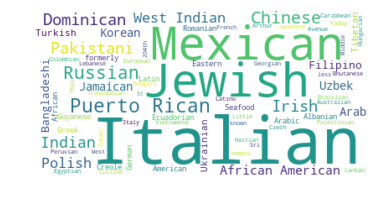

<Figure size 2160x3240 with 0 Axes>

In [137]:
# display the word cloud
plt.imshow(nyc_cuisine_wc, interpolation='bilinear')
plt.axis('off')

fig = plt.figure()
fig.set_figwidth(30)
fig.set_figheight(45)

plt.show()

#### From the word cloud, we can find that most popular food in NYC is Italian, then is Jewish and Mexican food.

### Finally, let's download and explore the farmers market dataset

In [141]:
# Data from website - https://data.cityofnewyork.us/dataset/DOHMH-Farmers-Markets-and-Food-Boxes/8vwk-6iz2
market = pd.read_csv('DOHMH_Farmers_Markets.csv')
market.columns = market.columns.str.replace(' ', '')
market

,Borough,MarketName,StreetAddress,Latitude,Longitude,DaysofOperation,HoursofOperations,SeasonDates,AcceptsEBT,OpenYear-Round,StellarCookingDemonstrations,FoodActivitiesforKids,LocationPoint
0,Brooklyn,Woodhull Hospital Youthmarket,Broadway & Flushing Ave,40.700726,-73.941932,Wednesday,9 a.m. - 2 p.m.,07/10/2019-11/27/2019,Yes,No,No,No,"(40.700726, -73.941932)"
1,Manhattan,Mount Sinai Hospital Greenmarket,E 99th St bet Madison & Park Aves,40.789169,-73.952743,Wednesday,8 a.m. - 5 p.m.,06/12/19-11/27/19,Yes,No,No,No,"(40.789169, -73.952743)"
2,Bronx,170 Farm Stand,E 170th St & Townsend Ave,40.839882,-73.916783,Wednesday,2:30 - 6:30 p.m.,07/10/2019-11/27/2019,Yes,No,No,Yes,"(40.839882, -73.916783)"
3,Manhattan,Greenmarket at Oculus Plaza,"Church & Fulton Sts, on Oculus Plaza",40.711535,-74.010464,Tuesday,7 a.m. - 7 p.m.,07/09/2019-11/30/19,Yes,Yes,No,No,"(40.711535, -74.010464)"
4,Queens,Ditmars Park Youthmarket,"Steinway St bet Ditmars Blvd & 23rd Ave, at Di...",40.772854,-73.906061,Saturday,8 a.m. - 3 p.m.,07/13/2019-11/23/2019,Yes,No,No,No,"(40.772854, -73.906061)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,Manhattan,Harvest Home 125th Street Market,W 125th St & Adam Clayton Powell Jr Blvd,40.808973,-73.948325,Tuesday,8 a.m. - 6 p.m.,06/26/2019-11/27/2019,Yes,No,No,No,"(40.808973, -73.948325)"
134,Manhattan,Union Square Greenmarket,E 17th St & Union Square W,40.737133,-73.990329,"Monday,\nWednesday,\nFriday & Saturday",8 a.m. - 6 p.m.,Year-Round,Yes,Yes,No,No,"(40.737133, -73.990329)"
135,Queens,Jamaica's Down to Earth Farmers Market - Frida...,Parsons Blvd bet Jamaica & Archer Aves,40.703342,-73.799921,Friday,8:30 a.m. - 4 p.m.,6/14/19-11/22/19,Yes,No,No,No,"(40.703342, -73.799921)"
136,Manhattan,Essex Crossing Farm Stand,115 Essex St,40.719322,-73.987817,Wednesday & Saturday,9 a.m. - 5 p.m.,07/08/2019-11/22/2019,Yes,No,No,No,"(40.719322, -73.987817)"


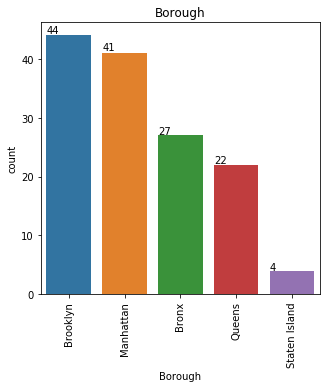

In [143]:
# Let's visualize the farmers market by borough
fig,ax = plt.subplots(1, 1, figsize=(5, 5))
sns.countplot(x='Borough',data=market)
ax.set_title("Borough")
for t in ax.patches:
    if (np.isnan(float(t.get_height()))):
        ax.annotate('', (t.get_x(), 0))
    else:
        ax.annotate(str(format(int(t.get_height()), ',d')), (t.get_x(), t.get_height()*1.01))
        ax.set_xticklabels([t.get_text().split("T")[0] for t in ax.get_xticklabels()])

# This sets the yticks "upright" with 0, as opposed to sideways with 90.
plt.xticks(rotation=90) 
plt.show()

From the graph we can see that Brooklyn and Manhattan are two boroughs with more farmers market

#### Create a new map with market name and borough of farmers market information on top

In [144]:
# create map of New York City using latitude and longitude values
map_markets = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, MarketName, borough in zip(market['Latitude'], market['Longitude'], market['MarketName'], market['Borough']):
            label = '{}, {}'.format(MarketName, borough)
            label = folium.Popup(label, parse_html=True)
            folium.CircleMarker(
                [lat, lng],
                radius=5,
                popup=label,
                color='green',
                fill=True,
                fill_color='green',
                fill_opacity=0.7,
                parse_html = False).add_to(map_markets)  

map_markets

### Segmenting and Clustering Neighbourhoods

First, let's take out the Brooklyn and Manhattan data from previous datasets

In [180]:
BM_Geo = nyc
BM_Geo = BM_Geo.reset_index(drop=True)
BM_Geo.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [181]:
# create map of New York using latitude and longitude values
map_BM = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(BM_Geo['Latitude'], BM_Geo['Longitude'], BM_Geo['Borough'], BM_Geo['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_BM)  
    
map_BM

#### Define Foursquare Credentials and Version

In [182]:
CLIENT_ID = 'LZ24YGJYBC1VJ1ZSBMZPN3E5TCAGQFRY0WHAI12N0DQF01CC' 
CLIENT_SECRET = 'WXQIFEIODVLPZWSJXU0FADRVQ4JO5HTCPFORHSA1AUXQ53JU' 
VERSION = '20181218' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: LZ24YGJYBC1VJ1ZSBMZPN3E5TCAGQFRY0WHAI12N0DQF01CC
CLIENT_SECRET:WXQIFEIODVLPZWSJXU0FADRVQ4JO5HTCPFORHSA1AUXQ53JU


### Explore Neighbourhoods 

Extract Venues data for each neighbourhoods

In [183]:
def getNearbyVenues(names, latitudes, longitudes, LIMIT=200, radius=1000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [184]:
# Run the function on each neighbourhood to get a new dataframe
BM_venues = getNearbyVenues(names=BM_Geo['Neighborhood'],
                                  latitudes=BM_Geo['Latitude'],
                                  longitudes=BM_Geo['Longitude'],
                                  LIMIT=200)

print('The "BM_venues" dataframe has {} venues and {} unique venue types.'.format(
      len(BM_venues['Venue Category']),
      len(BM_venues['Venue Category'].unique())))

BM_venues.to_csv('BM_venues.csv', sep=',', encoding='UTF8')
BM_venues.head()

Wakefield
Co-op City
Eastchester
Fieldston
Riverdale
Kingsbridge
Marble Hill
Woodlawn
Norwood
Williamsbridge
Baychester
Pelham Parkway
City Island
Bedford Park
University Heights
Morris Heights
Fordham
East Tremont
West Farms
High  Bridge
Melrose
Mott Haven
Port Morris
Longwood
Hunts Point
Morrisania
Soundview
Clason Point
Throgs Neck
Country Club
Parkchester
Westchester Square
Van Nest
Morris Park
Belmont
Spuyten Duyvil
North Riverdale
Pelham Bay
Schuylerville
Edgewater Park
Castle Hill
Olinville
Pelham Gardens
Concourse
Unionport
Edenwald
Bay Ridge
Bensonhurst
Sunset Park
Greenpoint
Gravesend
Brighton Beach
Sheepshead Bay
Manhattan Terrace
Flatbush
Crown Heights
East Flatbush
Kensington
Windsor Terrace
Prospect Heights
Brownsville
Williamsburg
Bushwick
Bedford Stuyvesant
Brooklyn Heights
Cobble Hill
Carroll Gardens
Red Hook
Gowanus
Fort Greene
Park Slope
Cypress Hills
East New York
Starrett City
Canarsie
Flatlands
Mill Island
Manhattan Beach
Coney Island
Bath Beach
Borough Park
Dyker

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Ripe Kitchen & Bar,40.898152,-73.838875,Caribbean Restaurant
2,Wakefield,40.894705,-73.847201,Ali's Roti Shop,40.894036,-73.856935,Caribbean Restaurant
3,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
4,Wakefield,40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop


In [185]:
colnames = ['Neighborhood', 'Neighborhood Latitude', 'Neighborhood Longitude', 'Venue', 'Venue Latitude', 'Venue Longitude', 'Venue Category']
BM_venues = pd.read_csv('BM_venues.csv', skiprows=1, names=colnames)
BM_venues.columns = BM_venues.columns.str.replace(' ', '')
BM_venues.head()

,Neighborhood,NeighborhoodLatitude,NeighborhoodLongitude,Venue,VenueLatitude,VenueLongitude,VenueCategory
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Ripe Kitchen & Bar,40.898152,-73.838875,Caribbean Restaurant
2,Wakefield,40.894705,-73.847201,Ali's Roti Shop,40.894036,-73.856935,Caribbean Restaurant
3,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
4,Wakefield,40.894705,-73.847201,Carvel Ice Cream,40.890487,-73.848568,Ice Cream Shop


#### Visualize the Venue data

In [205]:
# create map of New York using latitude and longitude values
map_BM = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, venue, category in zip(BM_venues['VenueLatitude'], BM_venues['VenueLongitude'], BM_venues['Venue'], BM_venues['VenueCategory']):
    label = '{}, {}'.format(category, venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.1,
        popup=label,
        color='red',
        fill=True,
        fill_color='#FF0000',
        fill_opacity=0.3).add_to(map_BM)  
    
map_BM

In [187]:
BM_venues.groupby('VenueCategory')['Venue'].count().sort_values(ascending=False)

VenueCategory
Pizza Place           1031
Coffee Shop            551
Italian Restaurant     539
Deli / Bodega          468
Donut Shop             461
                      ... 
Daycare                  1
Pastry Shop              1
Elementary School        1
Paintball Field          1
ATM                      1
Name: Venue, Length: 474, dtype: int64

In [188]:
# Check venues by neighbourhood.
BM_venues.groupby('Neighborhood').count()

,NeighborhoodLatitude,NeighborhoodLongitude,Venue,VenueLatitude,VenueLongitude,VenueCategory
Neighborhood,,,,,,
Allerton,73,73,73,73,73,73
Annadale,15,15,15,15,15,15
Arden Heights,23,23,23,23,23,23
Arlington,18,18,18,18,18,18
Arrochar,21,21,21,21,21,21
...,...,...,...,...,...,...
Woodhaven,67,67,67,67,67,67
Woodlawn,48,48,48,48,48,48
Woodrow,18,18,18,18,18,18


In [189]:
# Find out how many unique categories can be curated from all the returned venues
print('There are {} uniques categories.'.format(len(BM_venues['VenueCategory'].unique())))

There are 474 uniques categories.


#### Analyze Neighbourhoood

In [190]:
# one hot encoding
BM_onehot = pd.get_dummies(BM_venues[['VenueCategory']], prefix="", prefix_sep="")

#column lists before adding neighborhood
column_names = ['Neighborhood'] + list(BM_onehot.columns)

# add neighborhood column back to dataframe
BM_onehot['Neighborhood'] = BM_venues['Neighborhood'] 

# move neighborhood column to the first column
BM_onehot = BM_onehot[column_names]

BM_onehot.head()

,Neighborhood,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,...,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Wakefield,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [191]:
# Get restaurant information
restaurant_List = []
search = 'Restaurant'
for i in BM_onehot.columns :
    if search in i:
        restaurant_List.append(i)

In [192]:
restaurant_List

['Afghan Restaurant',
 'African Restaurant',
 'American Restaurant',
 'Arepa Restaurant',
 'Argentinian Restaurant',
 'Asian Restaurant',
 'Australian Restaurant',
 'Austrian Restaurant',
 'Brazilian Restaurant',
 'Burmese Restaurant',
 'Cajun / Creole Restaurant',
 'Cambodian Restaurant',
 'Cantonese Restaurant',
 'Caribbean Restaurant',
 'Caucasian Restaurant',
 'Chinese Restaurant',
 'Colombian Restaurant',
 'Comfort Food Restaurant',
 'Cuban Restaurant',
 'Czech Restaurant',
 'Dim Sum Restaurant',
 'Dumpling Restaurant',
 'Eastern European Restaurant',
 'Egyptian Restaurant',
 'Empanada Restaurant',
 'English Restaurant',
 'Ethiopian Restaurant',
 'Falafel Restaurant',
 'Fast Food Restaurant',
 'Filipino Restaurant',
 'French Restaurant',
 'German Restaurant',
 'Gluten-free Restaurant',
 'Greek Restaurant',
 'Halal Restaurant',
 'Hawaiian Restaurant',
 'Himalayan Restaurant',
 'Hotpot Restaurant',
 'Indian Restaurant',
 'Indonesian Restaurant',
 'Israeli Restaurant',
 'Italian Rest

In [193]:
col_name = []
col_name = ['Neighborhood'] + restaurant_List
BM_restaurant = BM_onehot[col_name]
BM_restaurant = BM_restaurant.iloc[:,1::]

In [194]:
BM_restaurant_grouped = BM_restaurant.groupby('Neighborhood').sum().reset_index()

In [195]:
BM_restaurant_grouped['Total'] = BM_restaurant_grouped .sum(axis=1)

### Cluster Neighbourhoods 

In [196]:
BM_grouped_clustering = BM_restaurant_grouped.drop('Neighborhood', 1)

for n_cluster in range(2, 10):
    kmeans = KMeans(n_clusters=n_cluster).fit(BM_grouped_clustering)
    label = kmeans.labels_
    sil_coeff = silhouette_score(BM_grouped_clustering, label, metric='euclidean')
    print("For n_clusters={}, The Silhouette Coefficient is {}".format(n_cluster, sil_coeff))

For n_clusters=2, The Silhouette Coefficient is 0.4746821839504221
For n_clusters=3, The Silhouette Coefficient is 0.36813657221322216
For n_clusters=4, The Silhouette Coefficient is 0.35674728772303327
For n_clusters=5, The Silhouette Coefficient is 0.2819250160866746
For n_clusters=6, The Silhouette Coefficient is 0.27796764105147437
For n_clusters=7, The Silhouette Coefficient is 0.24438965218209102
For n_clusters=8, The Silhouette Coefficient is 0.23690808889044251
For n_clusters=9, The Silhouette Coefficient is 0.21455825223973024


As we can see, n_clusters=2 has highest Silhouette Coefficient. This means that 2 should be the optimal number of clusters.
For n_clusters=2, The Silhouette Coefficient is 0.4746821839504221

Run k-means to cluster the neighborhood into 2 clusters.

In [197]:
# set number of clusters
kclusters = 2

BM_grouped_clustering = BM_restaurant_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(BM_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_

array([0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1,
       1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1,

In [198]:
BM_results = pd.DataFrame(kmeans.cluster_centers_)
BM_results.columns = BM_grouped_clustering.columns
BM_results.index = ['cluster0','cluster1']
BM_results['Total Sum'] = BM_results.sum(axis = 1)
BM_results

,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Austrian Restaurant,Brazilian Restaurant,Burmese Restaurant,...,Theme Restaurant,Tibetan Restaurant,Turkish Restaurant,Udon Restaurant,Ukrainian Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Total,Total Sum
cluster0,0.005291,0.031746,0.619048,0.031746,-1.249001e-16,0.216931,4.857226e-17,3.122502e-17,0.015873,-8.239937e-18,...,0.005291,6.245005e-17,0.015873,2.428613e-17,-8.239937e-18,0.074074,-1.647987e-17,0.031746,9.052910,18.105820
cluster1,0.017699,0.079646,1.725664,0.132743,1.504425e-01,0.628319,8.849558e-02,5.309735e-02,0.070796,8.849558e-03,...,0.008850,1.061947e-01,0.221239,4.424779e-02,8.849558e-03,0.548673,1.769912e-02,0.433628,28.141593,56.283186


In [199]:
BM_results_merged = pd.DataFrame(BM_restaurant_grouped['Neighborhood'])

BM_results_merged['Total'] = BM_restaurant_grouped['Total']
BM_results_merged = BM_results_merged.assign(Cluster_Labels = kmeans.labels_)

In [200]:

print(BM_results_merged.shape)
BM_results_merged

(302, 3)


,Neighborhood,Total,Cluster_Labels
0,Allerton,14,0
1,Annadale,2,0
2,Arden Heights,5,0
3,Arlington,1,0
4,Arrochar,5,0
...,...,...,...
297,Woodhaven,18,0
298,Woodlawn,7,0
299,Woodrow,3,0
300,Woodside,44,1


#### Merge BM_results_merged with BM_Geo

In [201]:
BM_merged = BM_Geo

BM_merged = BM_merged.join(BM_results_merged.set_index('Neighborhood'), on='Neighborhood')

print(BM_merged.shape)
BM_merged.head(10)

(306, 6)


,Borough,Neighborhood,Latitude,Longitude,Total,Cluster_Labels
0,Bronx,Wakefield,40.894705,-73.847201,9,0
1,Bronx,Co-op City,40.874294,-73.829939,12,0
2,Bronx,Eastchester,40.887556,-73.827806,12,0
3,Bronx,Fieldston,40.895437,-73.905643,7,0
4,Bronx,Riverdale,40.890834,-73.912585,9,0
5,Bronx,Kingsbridge,40.881687,-73.902818,20,1
6,Manhattan,Marble Hill,40.876551,-73.910660,14,0
7,Bronx,Woodlawn,40.898273,-73.867315,7,0
8,Bronx,Norwood,40.877224,-73.879391,15,0
9,Bronx,Williamsbridge,40.881039,-73.857446,15,0


#### Finally, let's visualize the resulting clusters

In [202]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(BM_merged['Latitude'], BM_merged['Longitude'], BM_merged['Neighborhood'], BM_merged['Cluster_Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

### List Neighborhoods of Interest in New York City

#### Cluster 1 : Saturated Markets

In [203]:
BM_merged[BM_merged['Cluster_Labels'] == 1].reset_index(drop=True)

,Borough,Neighborhood,Latitude,Longitude,Total,Cluster_Labels
0,Bronx,Kingsbridge,40.881687,-73.902818,20,1
1,Bronx,Fordham,40.860997,-73.896427,24,1
2,Bronx,Melrose,40.819754,-73.909422,19,1
3,Bronx,Parkchester,40.837938,-73.856003,25,1
4,Bronx,Belmont,40.857277,-73.888452,27,1
...,...,...,...,...,...,...
111,Brooklyn,Fulton Ferry,40.703281,-73.995508,20,1
112,Brooklyn,Weeksville,40.675040,-73.930531,29,1
113,Brooklyn,Dumbo,40.703176,-73.988753,19,1
114,Brooklyn,Homecrest,40.598525,-73.959185,26,1


#### Cluster 0 : Untapped Markets

In [204]:
BM_merged[BM_merged['Total'] == 0].reset_index(drop=True)

,Borough,Neighborhood,Latitude,Longitude,Total,Cluster_Labels
0,Staten Island,Todt Hill,40.597069,-74.111329,0,0
1,Staten Island,Port Ivory,40.639683,-74.174645,0,0
2,Staten Island,Butler Manor,40.506082,-74.229504,0,0
3,Staten Island,Bloomfield,40.605779,-74.187256,0,0
